<a href="https://colab.research.google.com/github/pritampalit/ML4DQM/blob/master/Double_AE_Step_by_Step_NormalizedHitResiduals_TIB_L1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [66]:
import tensorflow as tf
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))


Found GPU at: /device:GPU:0


In [67]:
import pandas as pd
#from google.colab import files
from google.colab import drive
drive.mount('/content/drive')
import matplotlib.pyplot as plt
import numpy as np
from ast import literal_eval
import json

df= pd.read_csv('/content/drive/My Drive/Colab Notebooks/ZeroBias_2017UL_DataFrame_NormalizedHitResiduals_TIB__Layer__1.txt')
df['histo']=df['histo'].apply(literal_eval)

df.set_index(['fromrun','fromlumi'], inplace=True, drop=False)
df.sort_index(inplace=True)
print(df['histo'].shape)
print(df.tail())
print(df.shape)
print(type(df))
print(type(df["histo"]))

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
(225954,)
                  Unnamed: 0  ...                                              histo
fromrun fromlumi              ...                                                   
306462  95            211180  ...  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...
        96            211181  ...  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...
        97            211182  ...  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...
        98            211183  ...  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...
        99            211184  ...  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...

[5 rows x 10 columns]
(225954, 10)
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>


In [68]:
import seaborn as sns
from pylab import rcParams
from keras.callbacks import ModelCheckpoint, TensorBoard
from keras import regularizers
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_recall_curve
from sklearn.metrics import recall_score, classification_report, auc, roc_curve
from sklearn.metrics import precision_recall_fscore_support, f1_score
from numpy.random import seed
seed(1)
import tensorflow
#from tensorflow import set_random_seed
tensorflow.random.set_seed(2)
#set_random_seed(2)
SEED = 123 #used to help randomly select the data points
DATA_SPLIT_PCT = 0.2
DATA_SPLIT_PCT_VALID = 0.1
rcParams['figure.figsize'] = 10, 6

In [69]:
#add Golden JSON labels to the DF
import json

def checkLS(run,ls):
    isok=False
    global jsondata

    if str(run) in jsondata.keys():
        for i in jsondata[str(run)]:
            if (ls>=i[0] and ls <=i[1]):
                isok=True
                return isok
        return   isok

#load the golden json file
jsondata={}
with open('/content/drive/My Drive/Colab Notebooks/GoldenJSON17.json') as json_file:
    jsondata = json.load(json_file)

df['labels']=False #initialize to false

for run in df['fromrun'].unique():
    for ls in df['fromlumi'][run]:
        df['labels'][run][ls]=checkLS(run,ls)

print(df[df['labels']==False].shape)
print(df[df['labels']==True].shape)

print(df.shape)


df['type']=df['labels']
df['type']=df['type'].apply(lambda x:0 if x== True else 1)

df['mse2']=""

(23655, 11)
(202299, 11)
(225954, 11)


In [70]:
df_train, df_test = train_test_split(df, test_size=DATA_SPLIT_PCT, random_state=SEED)
df_train, df_valid = train_test_split(df_train, test_size=DATA_SPLIT_PCT_VALID, random_state=SEED)

X_train_true_old = np.stack(df_train['histo'][df_train['labels']==True].values, axis=0)
X_train_true = np.reshape(X_train_true_old, (len(X_train_true_old), 102))[:, 1:-1]
X_train_true = np.reshape(X_train_true, (len(X_train_true_old),100))

X_train_false_old = np.stack(df_train['histo'][df_train['labels']==False].values, axis=0)
X_train_false = np.reshape(X_train_false_old, (len(X_train_false_old), 102))[:, 1:-1]
X_train_false = np.reshape(X_train_false, (len(X_train_false_old),100))

X_valid_true_old = np.stack(df_valid['histo'][df_valid['labels']==True].values, axis=0)
X_valid_true = np.reshape(X_valid_true_old, (len(X_valid_true_old), 102))[:, 1:-1]
X_valid_true = np.reshape(X_valid_true, (len(X_valid_true_old),100))

X_valid_false_old = np.stack(df_valid['histo'][df_valid['labels']==False].values, axis=0)
X_valid_false = np.reshape(X_valid_false_old, (len(X_valid_false_old), 102))[:, 1:-1]
X_valid_false = np.reshape(X_valid_false, (len(X_valid_false_old),100))

X_test_true_old = np.stack(df_test['histo'][df_test['labels']==True].values, axis=0)
X_test_true = np.reshape(X_test_true_old, (len(X_test_true_old), 102))[:, 1:-1]
X_test_true = np.reshape(X_test_true, (len(X_test_true_old),100))

X_test_false_old = np.stack(df_test['histo'][df_test['labels']==False].values, axis=0)
X_test_false = np.reshape(X_test_false_old, (len(X_test_false_old), 102))[:, 1:-1]
X_test_false = np.reshape(X_test_false, (len(X_test_false_old),100))

from sklearn.preprocessing import normalize

X_train_true_norm=normalize(X_train_true, norm='l1', axis=1) #normalise the sample, i.e the rows
X_train_false_norm=normalize(X_train_false, norm='l1', axis=1)

X_valid_true_norm=normalize(X_valid_true, norm='l1', axis=1) #normalise the sample, i.e the rows
X_valid_false_norm=normalize(X_valid_false, norm='l1', axis=1)

X_test_true_norm=normalize(X_test_true, norm='l1', axis=1) #normalise the sample, i.e the rows
X_test_false_norm=normalize(X_test_false, norm='l1', axis=1)


print(X_train_true_old.shape)
#print(len(X_train_true))
#print(np.reshape(X_train_true[1:-1].shape)

#print(X_train_true[25,-1])

#print(X_train_true)
print(df["histo"].shape)
print(X_train_true.shape)
print(X_train_true_old.shape)
print(X_test_true.shape)
print(X_test_false.shape)

(145591, 102)
(225954,)
(145591, 100)
(145591, 102)
(40496, 100)
(4695, 100)


In [71]:
#build the model
import math
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras.layers import Input, Dense
from keras.layers.advanced_activations import PReLU
from keras.models import Model
from keras import backend as K
import tensorflow as tf
from keras.models import load_model

def mseTop10(y_true, y_pred):
    top_values, _ = tf.nn.top_k(K.square(y_pred - y_true), k=10, sorted=True)
    mean=K.mean(top_values, axis=-1)
    return mean

nb_epoch = 100
batch_size = 500
input_dim = X_train_true_norm.shape[1] #num of predictor variables, 
encoding_dim = 20
#hidden_dim = int(encoding_dim / 2)
hidden_dim = 5
learning_rate = 1e-3

input_layer = Input(shape=(input_dim, ))
encoder = Dense(encoding_dim, activation="tanh")(input_layer)  #, activity_regularizer=regularizers.l1(learning_rate))(input_layer)
#encoder = Dense(hidden_dim, activation="tanh")(encoder)
decoder = Dense(hidden_dim, activation="tanh")(encoder)
decoder = Dense(encoding_dim, activation="tanh")(decoder)
decoder = Dense(input_dim, activation="tanh")(decoder)
autoencoder = Model(inputs=input_layer, outputs=decoder)
autoencoder.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 100)               0         
_________________________________________________________________
dense_5 (Dense)              (None, 20)                2020      
_________________________________________________________________
dense_6 (Dense)              (None, 5)                 105       
_________________________________________________________________
dense_7 (Dense)              (None, 20)                120       
_________________________________________________________________
dense_8 (Dense)              (None, 100)               2100      
Total params: 4,345
Trainable params: 4,345
Non-trainable params: 0
_________________________________________________________________


In [72]:
autoencoder.compile(metrics=['accuracy'],
                    loss=mseTop10,
                    optimizer='adam')
'''
cp = ModelCheckpoint(filepath="/content/drive/My Drive/Colab Notebooks/autoencoder_classifier.h5",
                               save_best_only=True,
                               verbose=0)
tb = TensorBoard(log_dir='/content/drive/My Drive/Colab Notebooks/logs',
                histogram_freq=0,
                write_graph=True,
                write_images=True)
                '''
history = autoencoder.fit(X_train_true_norm, X_train_true_norm,
                    epochs=nb_epoch,
                    batch_size=batch_size,
                    shuffle=True,
                    validation_data=(X_valid_true_norm, X_valid_true_norm),
                    verbose=1,
 #                   callbacks=[cp, tb]).history
                    ).history

Train on 145591 samples, validate on 16212 samples
Epoch 1/100
145591/145591 [==============================] - 2s 11us/step - loss: 7.3082e-05 - accuracy: 0.4253 - val_loss: 9.5437e-07 - val_accuracy: 0.4669
Epoch 2/100
145591/145591 [==============================] - 2s 10us/step - loss: 1.2651e-06 - accuracy: 0.4711 - val_loss: 9.4272e-07 - val_accuracy: 0.4647
Epoch 3/100
145591/145591 [==============================] - 1s 10us/step - loss: 1.2448e-06 - accuracy: 0.4690 - val_loss: 9.2168e-07 - val_accuracy: 0.4630
Epoch 4/100
145591/145591 [==============================] - 1s 10us/step - loss: 1.2079e-06 - accuracy: 0.4666 - val_loss: 8.9222e-07 - val_accuracy: 0.4587
Epoch 5/100
145591/145591 [==============================] - 2s 11us/step - loss: 1.1755e-06 - accuracy: 0.4621 - val_loss: 8.9242e-07 - val_accuracy: 0.4573
Epoch 6/100
145591/145591 [==============================] - 2s 10us/step - loss: 1.1273e-06 - accuracy: 0.4617 - val_loss: 8.4223e-07 - val_accuracy: 0.4538
E

In [73]:
print(history)

{'val_loss': [9.543735663336132e-07, 9.427223877259664e-07, 9.216754557320438e-07, 8.922164920679331e-07, 8.924178458612369e-07, 8.42231094443805e-07, 1.3007079189986138e-06, 7.754919281015225e-07, 7.706982688030268e-07, 6.94193393072566e-07, 6.595141981329967e-07, 6.377156676725221e-07, 7.507215418950448e-07, 6.130085582541905e-07, 5.981555506239423e-07, 5.952436758697933e-07, 5.981631869264765e-07, 5.907991879867678e-07, 5.922058246480173e-07, 1.7884129875642649e-06, 5.648170647088869e-07, 5.564286813174723e-07, 5.702288207328693e-07, 5.479765311737276e-07, 5.396409295264171e-07, 5.315755414365878e-07, 5.288333531725905e-07, 5.304445400631594e-07, 8.434671194121752e-07, 5.219480668911777e-07, 5.096638156383157e-07, 5.08061105927557e-07, 5.310852740525875e-07, 5.056456805141284e-07, 4.97984461874133e-07, 5.106907517255973e-07, 5.343071870345769e-07, 5.681886910403605e-07, 4.896892920825093e-07, 5.073359887804314e-07, 4.938855285003679e-07, 1.7751785288187041e-06, 4.843021611591258e-07

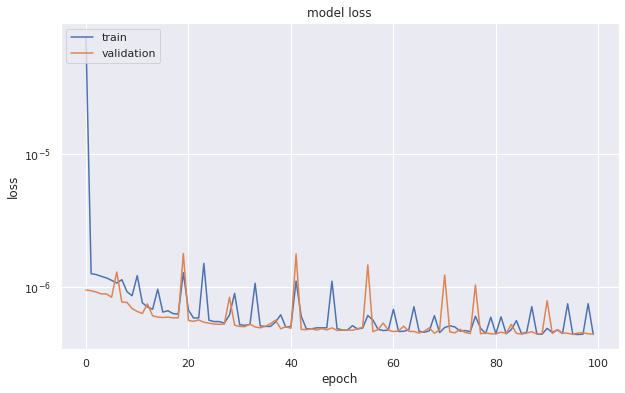

In [74]:
#print(history)

line_styles = [(0, ()), (0, (1, 3)), (0, (3, 2))]

color_palette = {"Indigo": {
                    50: "#E8EAF6",
                    100: "#C5CAE9",
                    200: "#9FA8DA",
                    300: "#7986CB",
                    400: "#5C6BC0",
                    500: "#3F51B5",
                    600: "#3949AB",
                    700: "#303F9F",
                    800: "#283593",
                    900: "#1A237E"},
                 "Teal": {      
                    50: "#E0F2F1",
                    100: "#B2DFDB",
                    200: "#80CBC4",
                    300: "#4DB6AC",
                    400: "#26A69A",
                    500: "#009688",
                    600: "#00897B",
                    700: "#00796B",
                    800: "#00695C",
                    900: "#004D40"}
                }

# "Loss"
plt.figure(1)
plt.plot(history['loss'])
plt.plot(history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.yscale("log")
#plt.xlim(0,100)
plt.show()

#plot_loss(history, "Original model loss")

In [120]:
from sklearn.metrics import confusion_matrix, precision_recall_curve
from sklearn.metrics import recall_score, classification_report, auc, roc_curve
from sklearn.metrics import precision_recall_fscore_support, f1_score
from numpy import sqrt
from numpy import argmax
import seaborn as sns

#Details of Reconstruction error for Test dataset
# df must have two columns : 'histo' & 'type' as described above
# 'true class' of column 'type' will help to classify '1' (Positive) for Anomaly and '0' (Negative) for Good, to draw ROC & P-R curves
def Skill_of_Classifier(df) :
  X_all_old = np.stack(df['histo'].values, axis=0)
  X_all = np.reshape(X_all_old, (len(X_all_old), 102))[:, 1:-1]
  X_all = np.reshape(X_all, (len(X_all_old),100))
  X_all_norm=normalize(X_all, norm='l1', axis=1)
  x_predictions = autoencoder.predict(X_all_norm)
  mse=K.eval(mseTop10(X_all_norm, x_predictions))
  print(mse)
  error_df = pd.DataFrame({'reconstruction_error': mse,'true_class': df['type']})
  print(error_df.describe())
  
  # Plot ROC curve and calculate g-mean to find the best point of ROC curve
  fpr, tpr, thresholds = roc_curve(error_df.true_class, error_df.reconstruction_error)
  roc_auc = auc(fpr, tpr)
  # calculate the g-mean for each threshold
  gmeans = sqrt(tpr * (1-fpr))
  # locate the index of the largest g-mean
  ix = argmax(gmeans)
  print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))
  fig = plt.figure(1)
  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, label='AUC = %0.4f'% roc_auc)
  plt.legend(loc='lower right')
  plt.plot([0,1],[0,1],'r--')
  plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')
  plt.xlim([-0.001, 1])
  plt.ylim([0, 1.001])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  
  # Plot PR curve and calculate f-score to find the best point of ROC curve
  precision, recall, th = precision_recall_curve(error_df.true_class, error_df.reconstruction_error)
  print(th, precision)
  auc_PR = auc(recall, precision)
  # convert to f score
  fscore = (2 * precision * recall) / (precision + recall)
  # locate the index of the largest f1 score
  ix = argmax(fscore)
  print('Best Threshold=%f, F-Score=%.3f' % (th[ix], fscore[ix]))
  plt.figure(2)
  plt.plot(recall, precision, 'b', label='AUC = %0.4f'% auc_PR)
  plt.legend(loc='lower left')
  plt.scatter(recall[ix], precision[ix], marker='o', color='black', label='Best')
  plt.title('Recall vs Precision')
  plt.xlabel('Recall')
  plt.ylabel('Precision')
  
  # Plot Precision and recall for different threshold values for to get the ideal threshold
  plt.figure(3)
  plt.plot(th, precision[1:], label="Precision",linewidth=5)
  plt.plot(th, recall[1:], label="Recall",linewidth=5)
  plt.legend(loc='right')
  plt.title('Precision and recall for different threshold values')
  plt.xlabel('Threshold')
  plt.xscale('log')
  plt.xlim([-0.001, 0.1])
  plt.ylabel('Precision/Recall')

  # Confusion Matrix to get the Actual Class vs Predicted Class
  threshold = th[ix] # Using threshold of PR curve
  #threshold = 0.0000012ZeroBias_2017UL_DataFrame_charge_PXDisk_+1.txt
  LABELS = ['Good', 'Anomaly']
  y_pred = [1 if e > threshold else 0 for e in error_df.reconstruction_error.values]
  conf_matrix = confusion_matrix(error_df.true_class, y_pred)
  plt.figure(5)
  #sns.set(font_scale=2.5)
  sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
  plt.title("Confusion matrix for Test, th = %f" % (th[ix]))
  plt.ylabel('True class')
  plt.xlabel('Predicted class')
  plt.show()


[2.52045615e-07 2.58101800e-07 1.95096097e-07 ... 3.31921431e-07
 2.17996982e-07 1.89082111e-07]
       reconstruction_error    true_class
count          4.519100e+04  45191.000000
mean           5.414252e-06      0.103892
std            5.046069e-04      0.305124
min            5.163900e-08      0.000000
25%            2.188243e-07      0.000000
50%            3.045810e-07      0.000000
75%            4.603074e-07      0.000000
max            8.564002e-02      1.000000
Best Threshold=0.000001, G-Mean=0.761
[5.37071096e-08 5.69433048e-08 5.71244675e-08 ... 4.24365570e-02
 4.69516125e-02 8.56400209e-02] [0.10389467 0.10387484 0.10387714 ... 1.         1.         1.        ]
Best Threshold=0.000001, F-Score=0.623


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:66: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.


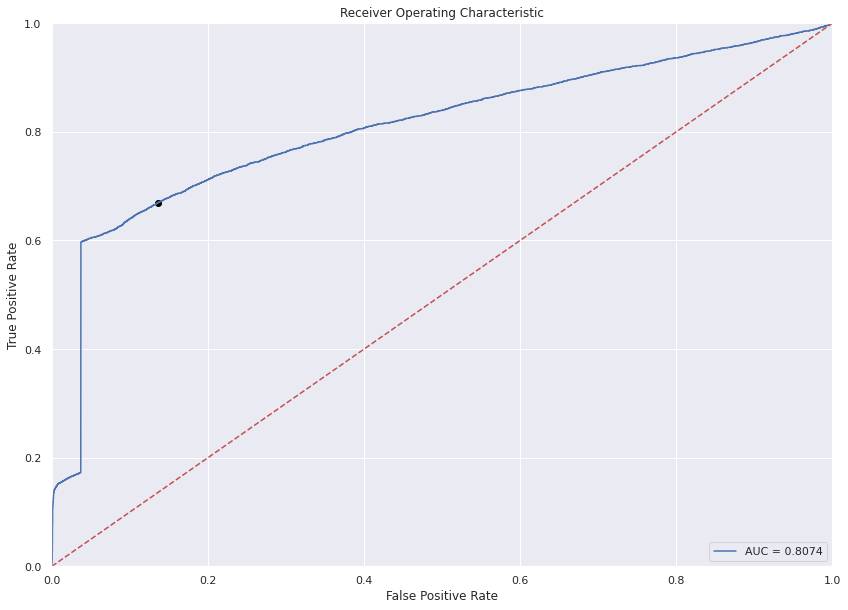

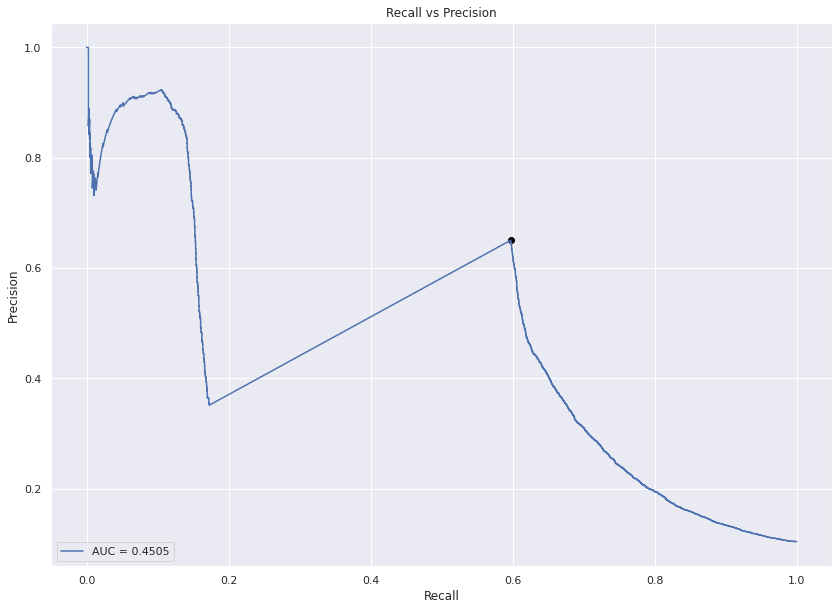

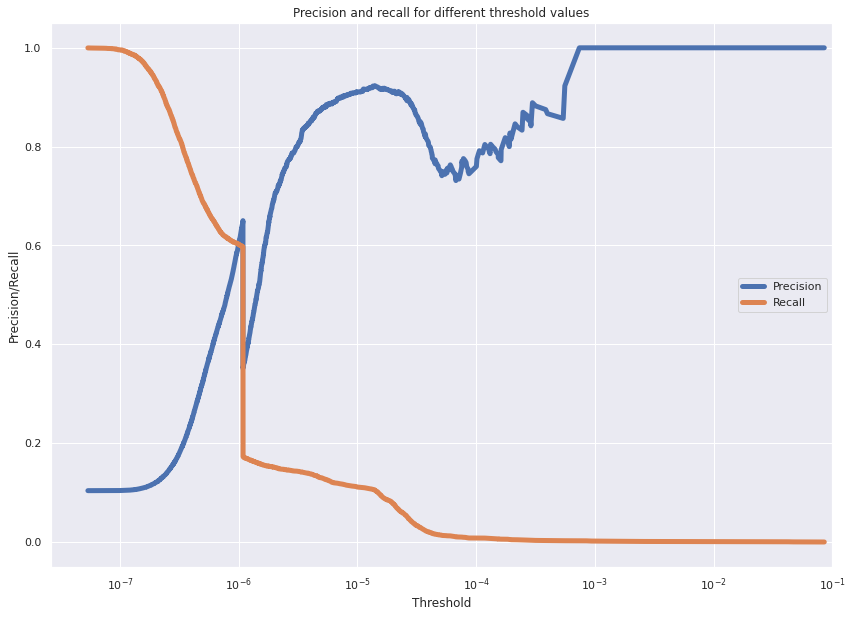

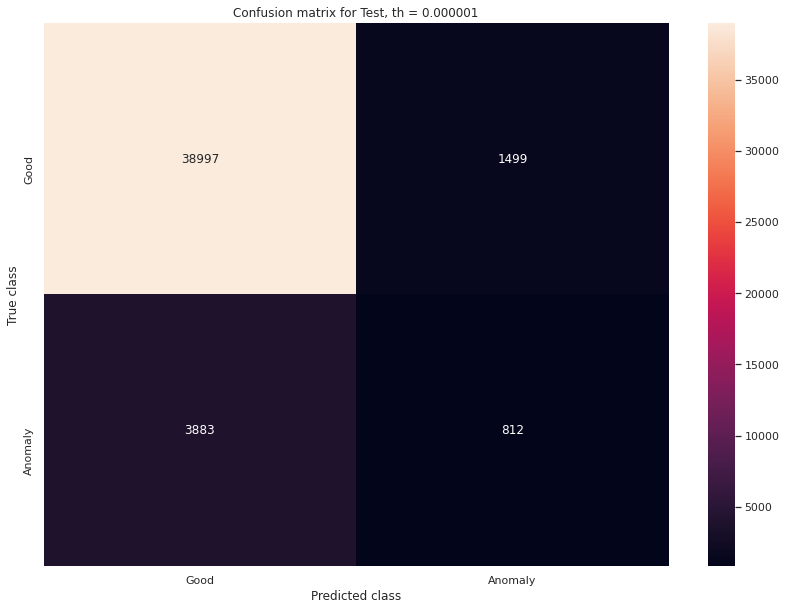

In [121]:
Skill_of_Classifier(df_test)

In [77]:
X_test_all_old = np.stack(df_test['histo'].values, axis=0)
X_test_all = np.reshape(X_test_all_old, (len(X_test_all_old), 102))[:, 1:-1]
X_test_all = np.reshape(X_test_all, (len(X_test_all_old),100))
X_test_all_norm=normalize(X_test_all, norm='l1', axis=1)

df_test['origin']=''
df_test['origin']=X_test_all_norm.tolist()

test_x_predictions = autoencoder.predict(X_test_all_norm)
#mse = np.mean(np.power(df_valid_x_rescaled - valid_x_predictions, 2), axis=1)finaloutput
mse_test=K.eval(mseTop10(X_test_all_norm, test_x_predictions))
print(mse_test)
error_df_test = pd.DataFrame({'reconstruction_error': mse_test,
                        'true_class': df_test['type']})
error_df_test.describe()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


[2.52045615e-07 2.58101800e-07 1.95096097e-07 ... 3.31921431e-07
 2.17996982e-07 1.89082111e-07]


,reconstruction_error,true_class
count,4.519100e+04,45191.000000
mean,5.414252e-06,0.103892
std,5.046069e-04,0.305124
min,5.163900e-08,0.000000
25%,2.188243e-07,0.000000
50%,3.045810e-07,0.000000
75%,4.603074e-07,0.000000
max,8.564002e-02,1.000000


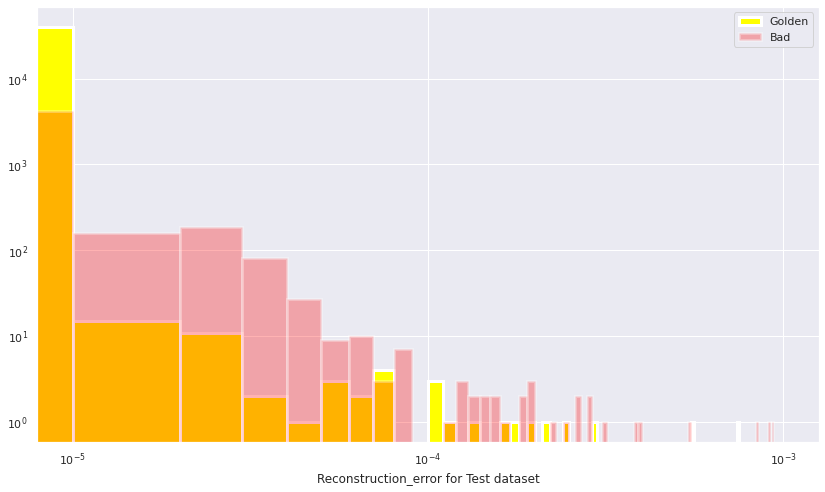

In [78]:
rcParams['figure.figsize'] = 14, 8
sns.set(font_scale=1)
'''
# reconstruction error for the normal transactions in the testing dataset
fig = plt.figure(1)
ax = fig.add_subplot(111)
Anomaly_error_df_valid = error_df_valid[(error_df_valid['true_class']== True)]
Golden_error_df_valid = error_df_valid[(error_df_valid['true_class']== False)]
ax.hist(Golden_error_df_valid.reconstruction_error.values, bins=1000, range=(0., 0.0002), color = 'yellow', ls='dashed',  alpha = 1.0, lw=3, log=True)
ax.hist(Anomaly_error_df_valid.reconstruction_error.values, bins=1000, range=(0., 0.0002), color = 'red', ls='dashed',  alpha = 0.3, lw=3, log=True)
#ax.set_alpha(0.9)
plt.show()
'''
# reconstruction error for the normal transactions in the testing dataset
#rcParams['figure.figsize'] = 10, 8
#Anomaly_error_df_train = error_df_train[(error_df_train['true_class']== True)]
#Golden_error_df_train = error_df_train[(error_df_train['true_class']== False)]
#Anomaly_error_df_valid = error_df_valid[(error_df_valid['true_class']== True)]
#Golden_error_df_valid = error_df_valid[(error_df_valid['true_class']== False)]
Anomaly_error_df_test = error_df_test[(error_df_test['true_class']== True)]
Golden_error_df_test = error_df_test[(error_df_test['true_class']== False)]
fig = plt.figure(1)
#ax = fig.add_subplot(131)
#ax = fig.add_subplot()
#ax.hist(Golden_error_df_train.reconstruction_error.values, bins=100, range=(0., 0.0010), color = 'yellow', label= 'Train : Golden', ls='dashed',  alpha = 1.0, lw=3, log=True)
#ax.hist(Anomaly_error_df_train.reconstruction_error.values, bins=100, range=(0., 0.0010), color = 'red', label= 'Train : Bad', ls='dashed',  alpha = 0.3, lw=3, log=True)
#ax.set_xlabel('Reconstruction_error for Train dataset')
#plt.legend(['Golden', 'Bad'], loc='upper right')
#fig = plt.figure(2)
#ax = fig.add_subplot(132)
#ax = fig.add_subplot()
#ax.hist(Golden_error_df_valid.reconstruction_error.values, bins=100, range=(0., 0.0010), color = 'yellow', label= 'validation : Golden', ls='dashed',  alpha = 1.0, lw=3, log=True)
#ax.hist(Anomaly_error_df_valid.reconstruction_error.values, bins=100, range=(0., 0.0010), color = 'red', label= 'Validation : Bad', ls='dashed',  alpha = 0.3, lw=3, log=True)
#ax.set_xlabel('Reconstruction_error for Validation dataset')
#plt.legend(['Golden', 'Bad'], loc='upper right')
#fig = plt.figure(3)
#ax = fig.add_subplot(133)
ax = fig.add_subplot()
ax.hist(Golden_error_df_test.reconstruction_error.values, bins=100, range=(0., 0.0010), color = 'yellow', label= 'Test : Golden',  alpha = 1.0, lw=3, log=True)
ax.hist(Anomaly_error_df_test.reconstruction_error.values, bins=100, range=(0., 0.0010), color = 'red', label= 'Test : Bad',  alpha = 0.3, lw=3, log=True)
ax.set_xlabel('Reconstruction_error for Test dataset')
#ax.set_alpha(0.9)
#plt.tight_layout()
plt.xscale('log')
plt.legend(['Golden', 'Bad'], loc='upper right')
plt.show()


In [79]:
df_test['origin']=''
df_test['origin']=X_test_all_norm.tolist()
df_test['prediction2']=test_x_predictions.tolist()
df_test['mse2']=mse_test
#print(df_test.head())

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documen

In [82]:
def CheckAllPredictions(df_test, run, ls):

    Xmax=80000.0
    Xmin=0.0
    Xbins=100
    hname="chargeInner_PXLayer_1"
    
    ahisto=df_test['origin'][run][ls]
    #ahisto1=df_test['prediction'][run][ls]
    ahisto2=df_test['prediction2'][run][ls]
    #mse=df_test['mse'][run][ls]
    mse2=df_test['mse2'][run][ls]
    
    x= np.linspace(Xmin,Xmax,Xbins)
    #plt.xlim(Xmin,Xmax)
    
    plt.step(x, ahisto, where='mid', label=(" LS : " + str(df_test.fromlumi[run][ls]) + " Run : " + str(df_test.fromrun[run][ls]) ))
    #plt.step(x, ahisto1, where='mid', label=" Raw Reco, mse:" + str(mse))
    plt.step(x, ahisto2, where='mid', label=" Reco, mse:" + str(mse2))
    plt.xlabel("Charge electrons")
    plt.ylabel("A.U")
    plt.legend(bbox_to_anchor=(0, 1), loc='lower right', ncol=1)
    plt.show()

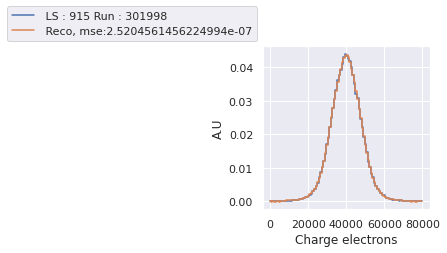

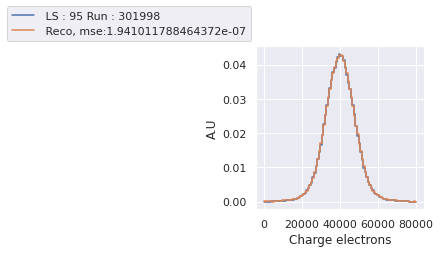

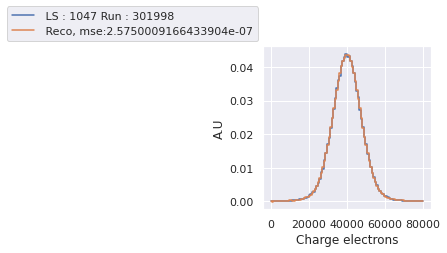

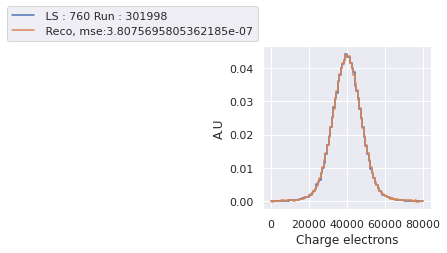

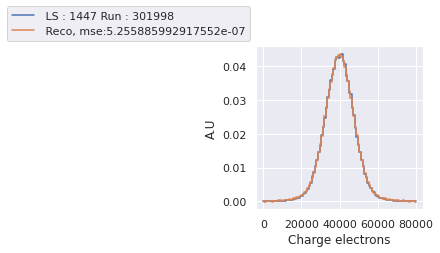

...

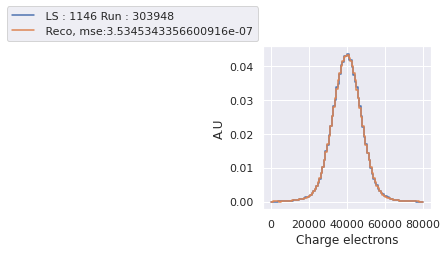

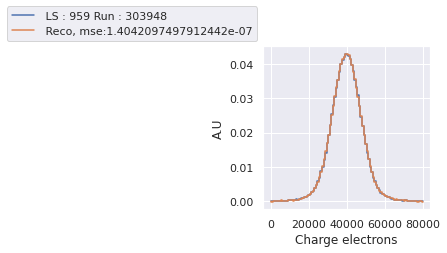

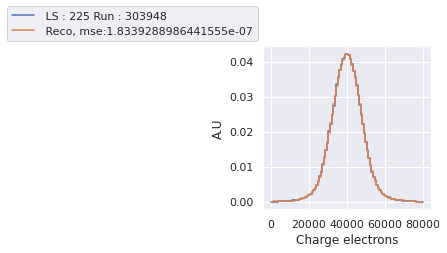

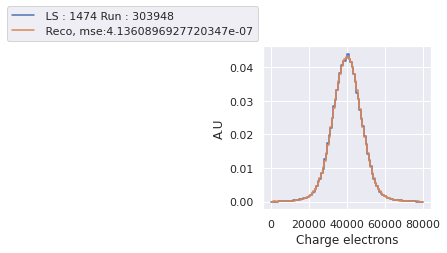

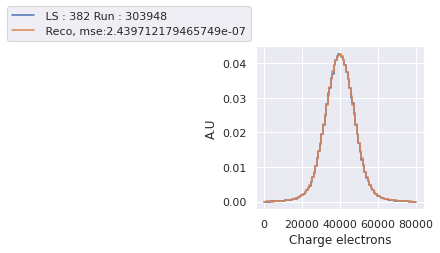

KeyboardInterrupt: ignored

In [81]:
rcParams['figure.figsize'] = 3, 3
for run in df_test['fromrun'].unique():
    count=0
    #if run <298000: continue
    for ls in df_test['fromlumi'][run]: 
        #if df['train'][run][ls]== True: continue
        #if ((df_test['mse2'][run][ls]<0.0001) or (df_test['mse2'][run][ls] > 0.0002)) : continue
        if df_test['mse2'][run][ls] > 0.0001 : continue
        #if df['entries'][run][ls]<3000: continue
        #if (count >2): continue
        count=count+1
        #print(df.entries)[run][ls]
        CheckAllPredictions(df_test, run,ls)

In [83]:
X_all_old = np.stack(df['histo'].values, axis=0)
X_all = np.reshape(X_all_old, (len(X_all_old), 102))[:, 1:-1]
X_all = np.reshape(X_all, (len(X_all_old),100))

X_all_good_old = np.stack(df['histo'][df['labels']==True].values, axis=0)
X_all_good = np.reshape(X_all_good_old, (len(X_all_good_old), 102))[:, 1:-1]
X_all_good = np.reshape(X_all_good, (len(X_all_good_old),100))

X_all_bad_old = np.stack(df['histo'][df['labels']==False].values, axis=0)
X_all_bad = np.reshape(X_all_bad_old, (len(X_all_bad_old), 102))[:, 1:-1]
X_all_bad = np.reshape(X_all_bad, (len(X_all_bad_old),100))

X_all_norm=normalize(X_all, norm='l1', axis=1)
X_all_good_norm=normalize(X_all_good, norm='l1', axis=1)
X_all_bad_norm=normalize(X_all_bad, norm='l1', axis=1)

x_predictions = autoencoder.predict(X_all_norm)
x_good_predictions = autoencoder.predict(X_all_good_norm)
x_bad_predictions = autoencoder.predict(X_all_bad_norm)
#mse = np.mean(np.power(df_valid_x_rescaled - valid_x_predictions, 2), axis=1)
mse_all=K.eval(mseTop10(X_all_norm, x_predictions))
mse_good_all=K.eval(mseTop10(X_all_good_norm, x_good_predictions))
mse_bad_all=K.eval(mseTop10(X_all_bad_norm, x_bad_predictions))
#mse_test=np.mean(np.power(X_test_all_norm - test_x_predictions, 2), axis=1)
print(mse_all)
error_df_all = pd.DataFrame({'reconstruction_error': mse_all,
                        'true_class': df['type']})
error_df_all.describe()


[3.96896727e-07 1.59212505e-07 1.81130674e-07 ... 1.08710505e-06
 1.08710984e-06 1.08710984e-06]


,reconstruction_error,true_class
count,2.259540e+05,225954.000000
mean,7.681041e-06,0.104689
std,7.049922e-04,0.306154
min,3.558649e-08,0.000000
25%,2.180174e-07,0.000000
50%,3.034458e-07,0.000000
75%,4.590908e-07,0.000000
max,1.019005e-01,1.000000


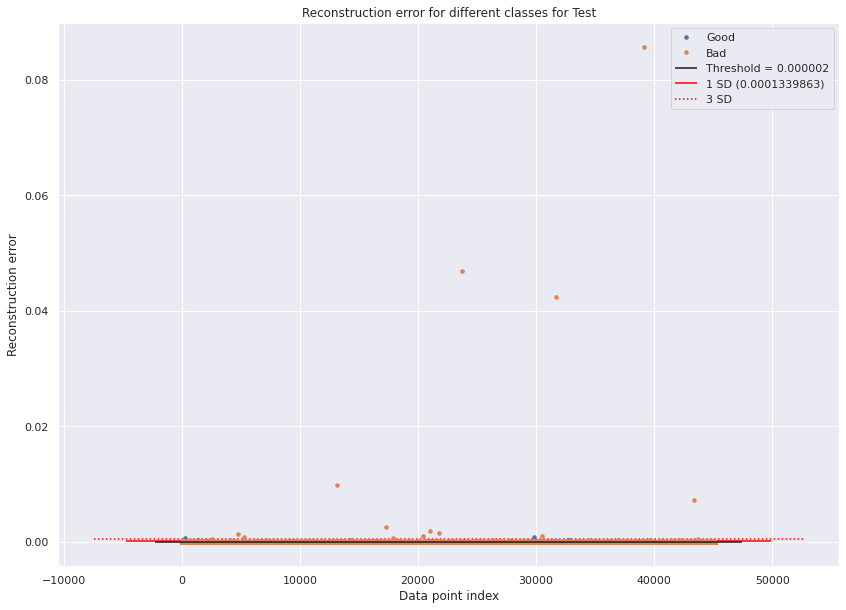

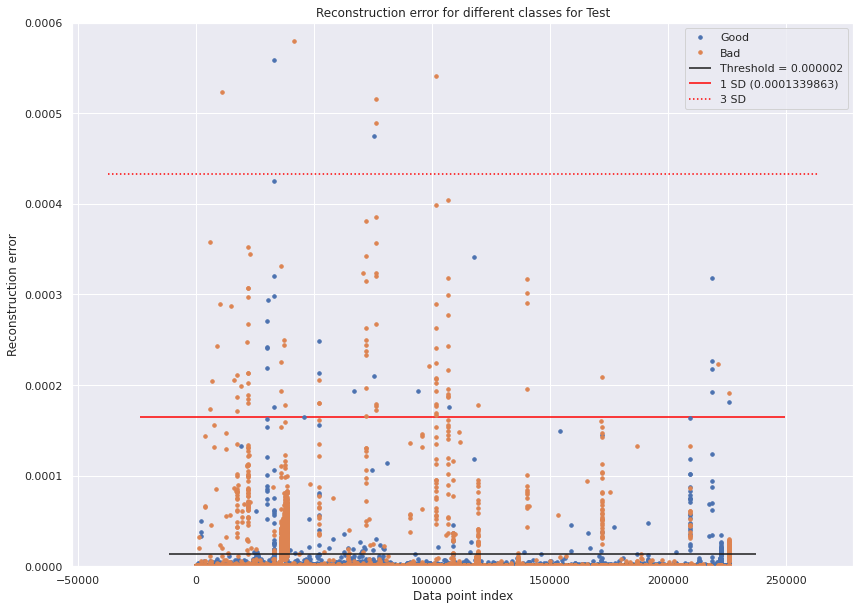

In [84]:
rcParams['figure.figsize'] = 14, 10

error_df_test = error_df_test.reset_index(drop=True)
threshold_fixed_test = 0.000013
groups = error_df_test.groupby('true_class')
gmean= 3.100298e-05 
gstd = 1.339863e-04
fig, ax = plt.subplots()

for name, group in groups:
    ax.plot(group.index, group.reconstruction_error, marker='o', ms=3.5, linestyle='', 
            label= "Bad" if name == 1 else "Good")
ax.hlines(threshold_fixed_test, ax.get_xlim()[0], ax.get_xlim()[1], colors="k", zorder=100, label='Threshold = 0.000002')
#ax.hlines(gmean, ax.get_xlim()[0], ax.get_xlim()[1], color="blue", label="Run average: " + str(gmean))
ax.hlines(gmean+(1.0*gstd), ax.get_xlim()[0], ax.get_xlim()[1], color="red", label='1 SD (' + str(gstd) + ")")
ax.hlines(gmean+(3.0*gstd), ax.get_xlim()[0], ax.get_xlim()[1], color="red", label='3 SD', linestyle=':')    
ax.legend()
plt.title("Reconstruction error for different classes for Test")
plt.ylabel("Reconstruction error")
plt.xlabel("Data point index")
plt.show();

error_df_all = error_df_all.reset_index(drop=True)
threshold_fixed_all = 0.000014
groups = error_df_all.groupby('true_class')
#gmean= 3.100298e-05 
#gstd = 1.339863e-04
fig, ax = plt.subplots()

for name, group in groups:
    ax.plot(group.index, group.reconstruction_error, marker='o', ms=3.5, linestyle='', 
            label= "Bad" if name == 1 else "Good")
ax.hlines(threshold_fixed_all, ax.get_xlim()[0], ax.get_xlim()[1], colors="k", zorder=100, label='Threshold = 0.000002')
#ax.hlines(gmean, ax.get_xlim()[0], ax.get_xlim()[1], color="blue", label="Run average: " + str(gmean))
ax.hlines(gmean+(1.0*gstd), ax.get_xlim()[0], ax.get_xlim()[1], color="red", label='1 SD (' + str(gstd) + ")")
ax.hlines(gmean+(3.0*gstd), ax.get_xlim()[0], ax.get_xlim()[1], color="red", label='3 SD', linestyle=':')    
ax.legend()
#plt.scatter(df['fromrun'].unique(), y, marker='+', label='Data points')
plt.ylim([0.0, 0.0006])
plt.title("Reconstruction error for different classes for Test")
plt.ylabel("Reconstruction error")
plt.xlabel("Data point index")
plt.show();


In [85]:
df['mse2']=mse_all
df['mse2'].loc[df['labels']==True]=mse_good_all
df['mse2'].loc[df['labels']==False]=mse_bad_all
def globalMSETrend(df):
    
    y=[]
    
    rmax=0
    rmin=10
    
    print(rmax, rmin)
    for run in df['fromrun'].unique():
        #if (type==1): val=(df['mse'][run]).mean()
        val=(df['mse2'][run]).mean()
        if val > rmax: rmax=val
        if val < rmin: rmin =val
        y.append(val)
    
    array=np.array(y)
    gmean=array.mean()
    size=float(array.size)
    gstd=array.std()
    print(size)
    
    fig=plt.figure()
    fig.set_size_inches(16, 9)
    
    plt.hlines(gmean,df['fromrun'].unique().min(), df['fromrun'].unique().max(), color="blue", label="Run average: " + str(gmean))
    plt.hlines(gmean+(1.0*gstd), df['fromrun'].unique().min(), df['fromrun'].unique().max(), color="red", label='1 SD (' + str(gstd) + ")")
    plt.hlines(gmean+(3.0*gstd), df['fromrun'].unique().min(), df['fromrun'].unique().max(), color="red", label='3 SD', linestyle=':')
    
    plt.ylim(rmin*0.9,rmax*1.1)
    plt.scatter(df['fromrun'].unique(), y, marker='+', label='Data points')
    plt.xlabel("Run")
    plt.ylabel("average MSE")
    plt.legend()
    plt.show()

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


In [86]:
def globalMSETrendAll(df):
    dff = df[df.labels==False]
    yf=[]
    #print (dff.head())
    rmax=0
    rmin=10
    
    #print(rmax, rmin)
    for run in dff['fromrun'].unique():
        #if (type==1): val=(dff['mse'][run]).mean()
        val=(dff['mse2'][run]).mean()
        if val > rmax: rmax=val
        if val < rmin: rmin =val
        yf.append(val)
    
    arrayf=np.array(yf)
    gmeanf=arrayf.mean()
    sizef=float(arrayf.size)
    gstdf=arrayf.std()
    print(sizef)
##################
    dft = df[df.labels==True]
    y=[]
    
    rmax=0
    rmin=10
    
    print(rmax, rmin)
    for run in dft['fromrun'].unique():
        #if (type==1): val=(dft['mse'][run]).mean()
        val=(dft['mse2'][run]).mean()
        if val > rmax: rmax=val
        if val < rmin: rmin =val
        y.append(val)
    
    array=np.array(y)
    gmean=array.mean()
    size=float(array.size)
    gstd=array.std()
    print(size)
    
#######################

    fig=plt.figure()
    fig.set_size_inches(16, 9)
    
    plt.hlines(gmean,dft['fromrun'].unique().min(), dft['fromrun'].unique().max(), color="blue", label="Good Run average: 7.88877651e-07" )
    plt.hlines(0.0000012, dft['fromrun'].unique().min(), dft['fromrun'].unique().max(), colors="yellow", zorder=100, label='Threshold = 0.0000012')
    #plt.hlines(gmean+(1.0*gstd), dft['fromrun'].unique().min(), dft['fromrun'].unique().max(), color="red", label='1 SD (' + str(gstd) + ")")
    #plt.hlines(gmean+(3.0*gstd), dft['fromrun'].unique().min(), dft['fromrun'].unique().max(), color="red", label='3 SD', linestyle=':')
    
    plt.hlines(gmeanf,dff['fromrun'].unique().min(), dff['fromrun'].unique().max(), color="green", label="Bad Run average : 0.00011726"  )
    #plt.hlines(gmeanf+(1.0*gstd), dff['fromrun'].unique().min(), dff['fromrun'].unique().max(), color="green", label='1 SD (' + str(gstdf) + ")")
    #plt.hlines(gmeanf+(3.0*gstd), dff['fromrun'].unique().min(), dff['fromrun'].unique().max(), color="green", label='3 SD', linestyle=':')
    
    
    #plt.ylim(rmin*0.9,rmax*1.1)
    plt.ylim([0.0,0.0003])
    plt.scatter(dft['fromrun'].unique(), y, marker='+', label='Good Data points')
    plt.scatter(dff['fromrun'].unique(), yf, marker='+', label='Bad Data points',color="red", alpha = 0.3)
    plt.xlabel("Run")
    plt.ylabel("average MSE")
    plt.legend(bbox_to_anchor=(0, 1), loc='lower left', ncol=1)
    plt.show()
	


465.0
0 10
469.0


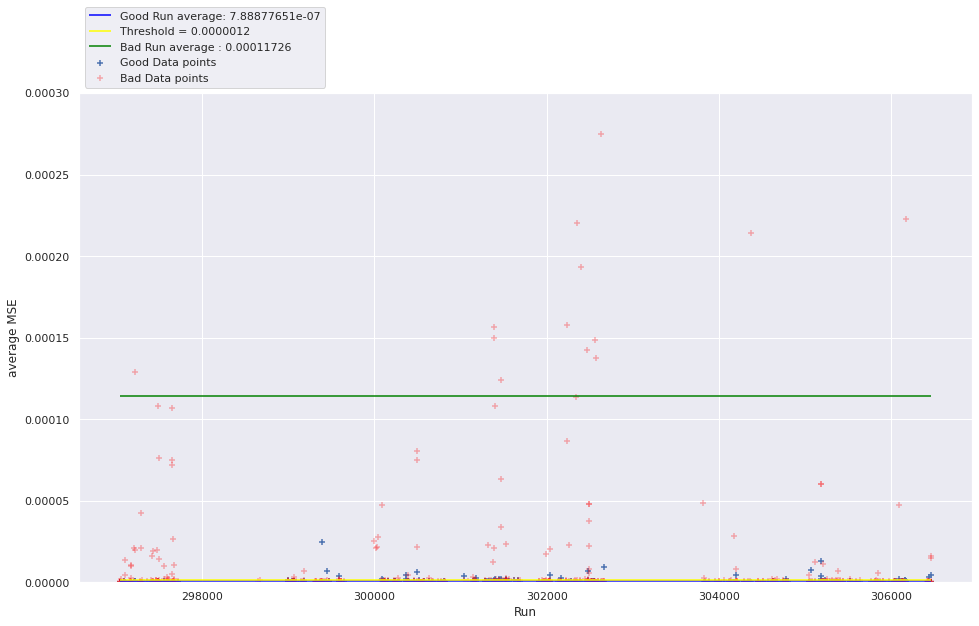

In [87]:
globalMSETrendAll(df)

In [88]:
#df_good_res= pd.read_csv('/content/drive/My Drive/Colab Notebooks/finaloutput/final_good.csv', names = ["histo"])

#f1 = np.loadtxt('/content/drive/My Drive/Colab Notebooks/finaloutput/final_good.csv')
#print (f1.shape)


file = open('/content/drive/My Drive/Colab Notebooks/fileoutput/final_good.csv.csv')
l = []
for line in file : 

  lt = [float(i) for i in line.split()]
  
  l.append(lt)
print(len(l))
print(np.array(l).shape)
df_ex = pd.DataFrame(data=np.array(l))
print(df_ex.shape)
df_good_res = pd.DataFrame()
df_good_res["histo"]=l
print(df_good_res["histo"].shape)
#print(len(np.unique(np.array(l))))

#print(type(df_good_res["histo"]))
#print(df_good_res.shape)
df_good_res["type"]=0
#print(df_good_res["type"].shape)
#print(df_good_res.head)

#df_bad_res= pd.read_csv('/content/drive/My Drive/Colab Notebooks/finaloutput/final_bad.csv', names = ["histo"])
#df_bad_res=df_bad_res.apply(literal_eval)
#print(df_bad_res)
#print(df_bad_res.shape)
file_bad = open('/content/drive/My Drive/Colab Notebooks/fileoutput/final_bad.csv.csv')
l_bad = []
for line in file_bad : 

  lt = [float(i) for i in line.split()]
  
  l_bad.append(lt)

df_bad_res = pd.DataFrame()
df_bad_res["histo"]=l_bad
print(df_bad_res["histo"].shape)

df_bad_res["type"]=1
#print(df_bad_res["type"].shape)
#print(df_bad_res.head)

df_res_tot = pd.concat([df_good_res, df_bad_res ], ignore_index=True)
print(df_res_tot)
'''
dfs = [df_good_res, df_bad_res]
n_dfs = len(dfs)
nrows = dfs[0].shape[0]
ncols = dfs[0].shape[1]
A = pd.concat(dfs, axis=1).values.reshape(nrows,-1,ncols)
sidx = np.random.rand(nrows,n_dfs).argsort(1)
out_arr = A[np.arange(nrows)[:,None],sidx,:].reshape(nrows,-1)
df_res_tot = pd.DataFrame(out_arr)
df_res_tot.head
'''
#df_res_tot["histo"].str.split(expand=True)


40700
(40700, 102)
(40700, 102)
(40700,)
(5000,)
                                                   histo  type
0      [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.06653475...     0
1      [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.6121671463497...     0
2      [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...     0
3      [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...     0
4      [0.0, 0.0, 0.0, 0.0, 0.0, 1.8539834099351624, ...     0
...                                                  ...   ...
45695  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...     1
45696  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...     1
45697  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...     1
45698  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...     1
45699  [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...     1

[45700 rows x 2 columns]


'\ndfs = [df_good_res, df_bad_res]\nn_dfs = len(dfs)\nnrows = dfs[0].shape[0]\nncols = dfs[0].shape[1]\nA = pd.concat(dfs, axis=1).values.reshape(nrows,-1,ncols)\nsidx = np.random.rand(nrows,n_dfs).argsort(1)\nout_arr = A[np.arange(nrows)[:,None],sidx,:].reshape(nrows,-1)\ndf_res_tot = pd.DataFrame(out_arr)\ndf_res_tot.head\n'

In [112]:
from sklearn.metrics import confusion_matrix, precision_recall_curve
from sklearn.metrics import recall_score, classification_report, auc, roc_curve
from sklearn.metrics import precision_recall_fscore_support, f1_score
from numpy import sqrt
from numpy import argmax
import seaborn as sns

#Details of Reconstruction error for Test dataset
# df must have two columns : 'histo' & 'type' as described above
# 'true class' of column 'type' will help to classify '1' (Positive) for Anomaly and '0' (Negative) for Good, to draw ROC & P-R curves
def Skill_of_Classifier(df) :
  X_all_old = np.stack(df['histo'].values, axis=0)
  X_all = np.reshape(X_all_old, (len(X_all_old), 102))[:, 1:-1]
  X_all = np.reshape(X_all, (len(X_all_old),100))
  X_all_norm=normalize(X_all, norm='l1', axis=1)
  x_predictions = autoencoder.predict(X_all_norm)
  mse=K.eval(mseTop10(X_all_norm, x_predictions))
  print(mse)
  error_df = pd.DataFrame({'reconstruction_error': mse,'true_class': df['type']})
  print(error_df.describe())
  
  # Plot ROC curve and calculate g-mean to find the best point of ROC curve
  fpr, tpr, thresholds = roc_curve(error_df.true_class, error_df.reconstruction_error)
  roc_auc = auc(fpr, tpr)
  # calculate the g-mean for each threshold
  gmeans = sqrt(tpr * (1-fpr))
  # locate the index of the largest g-mean
  ix = argmax(gmeans)
  print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))
  fig = plt.figure(1)
  plt.title('Receiver Operating Characteristic')
  plt.plot(fpr, tpr, label='AUC = %0.4f'% roc_auc)
  plt.legend(loc='lower right')
  plt.plot([0,1],[0,1],'r--')
  plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')
  plt.xlim([-0.001, 1])
  plt.ylim([0, 1.001])
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  
  # Plot PR curve and calculate f-score to find the best point of ROC curve
  precision, recall, th = precision_recall_curve(error_df.true_class, error_df.reconstruction_error)
  print(th, precision)
  auc_PR = auc(recall, precision)
  # convert to f score
  fscore = (2 * precision * recall) / (precision + recall)
  # locate the index of the largest f1 score
  ix = argmax(fscore)
  print('Best Threshold=%f, F-Score=%.3f' % (th[ix], fscore[ix]))
  plt.figure(2)
  plt.plot(recall, precision, 'b', label='AUC = %0.4f'% auc_PR)
  plt.legend(loc='lower left')
  plt.scatter(recall[ix], precision[ix], marker='o', color='black', label='Best')
  plt.title('Recall vs Precision')
  plt.xlabel('Recall')
  plt.ylabel('Precision')
  
  # Plot Precision and recall for different threshold values for to get the ideal threshold
  plt.figure(3)
  plt.plot(th, precision[1:], label="Precision",linewidth=5)
  plt.plot(th, recall[1:], label="Recall",linewidth=5)
  plt.legend(loc='right')
  plt.title('Precision and recall for different threshold values')
  plt.xlabel('Threshold')
  plt.xscale('log')
  plt.xlim([-0.1, 0.0001])
  plt.ylabel('Precision/Recall')

  # Confusion Matrix to get the Actual Class vs Predicted Class
  threshold = th[ix] # Using threshold of PR curve
  #threshold = 0.0000012ZeroBias_2017UL_DataFrame_charge_PXDisk_+1.txt
  LABELS = ['Good', 'Anomaly']
  y_pred = [1 if e > threshold else 0 for e in error_df.reconstruction_error.values]
  conf_matrix = confusion_matrix(error_df.true_class, y_pred)
  plt.figure(5)
  #sns.set(font_scale=2.5)
  sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
  plt.title("Confusion matrix for Test, th = %f" % (th[ix]))
  plt.ylabel('True class')
  plt.xlabel('Predicted class')
  plt.show()


[2.38917125e-05 3.36032189e-05 4.00187887e-05 ... 4.04078611e-02
 4.42710483e-02 4.05724593e-02]
       reconstruction_error    true_class
count          45700.000000  45700.000000
mean               0.001749      0.109409
std                0.009312      0.312155
min                0.000008      0.000000
25%                0.000024      0.000000
50%                0.000030      0.000000
75%                0.000039      0.000000
max                0.085265      1.000000
Best Threshold=0.000077, G-Mean=1.000
[7.66930604e-05 7.80209980e-05 7.87517130e-05 ... 8.50857515e-02
 8.51548170e-02 8.52650241e-02] [0.99800399 0.99800359 0.99820288 ... 1.         1.         1.        ]
Best Threshold=0.000086, F-Score=0.999


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:66: UserWarning: Attempted to set non-positive left xlim on a log-scaled axis.
Invalid limit will be ignored.


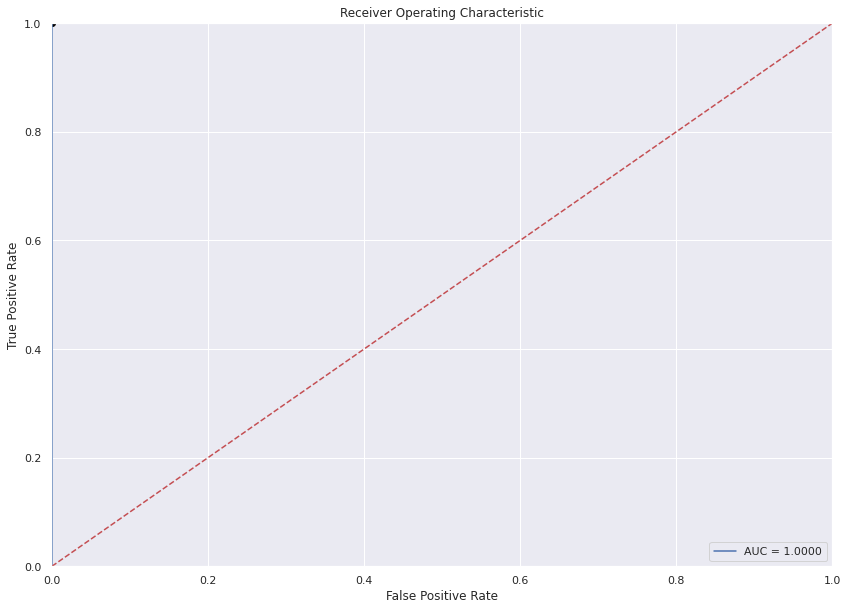

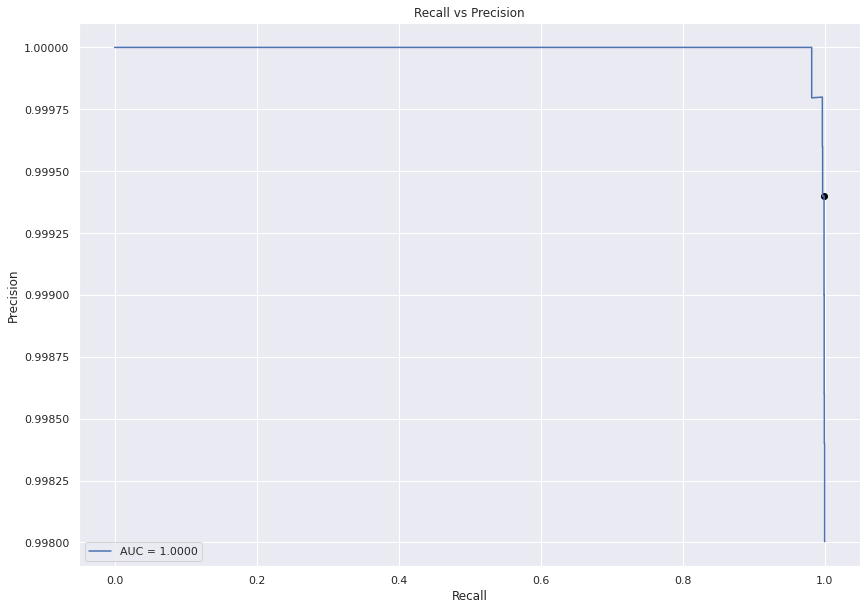

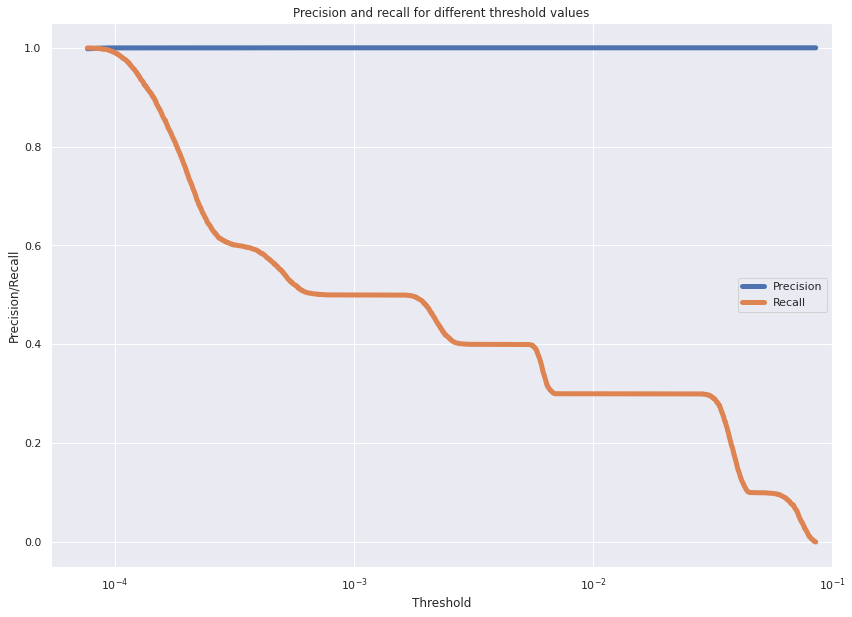

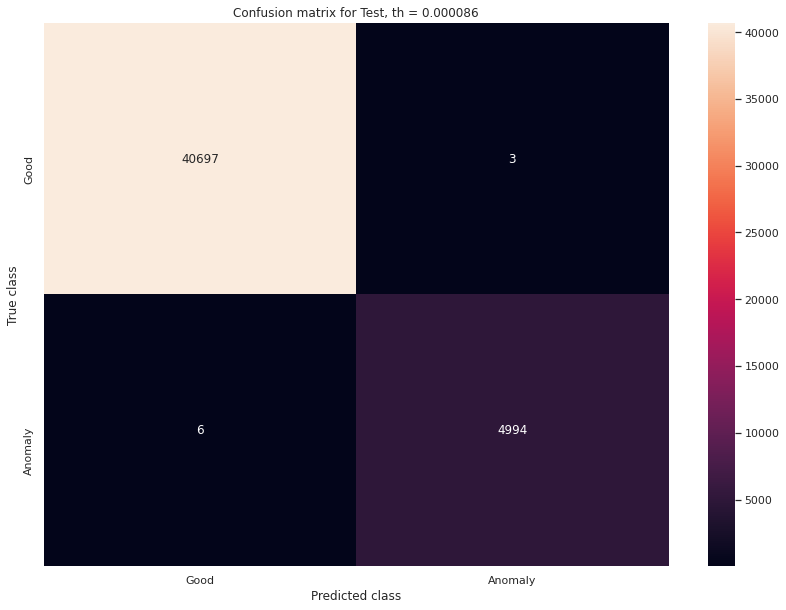

In [122]:
Skill_of_Classifier(df_res_tot)

In [123]:
X_test_res_all_old = np.stack(df_res_tot['histo'].values, axis=0)
#X_test_res_all.reshape(len(X_test_res_all), 100)
#np.hsplit(X_test_res_all,100)
#print(type(X_test_res_all))
print(X_test_res_all_old)
print(X_test_res_all_old.shape)
X_test_res_all = np.reshape(X_test_res_all_old, (len(X_test_res_all_old), 102))[:, 1:-1]
X_test_res_all = np.reshape(X_test_res_all, (len(X_test_res_all_old),100))
X_test_res_all_norm=normalize(X_test_res_all, norm='l1', axis=1)
print(X_test_res_all_norm.shape)

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
(45700, 102)
(45700, 100)


In [134]:
df_res_tot['origin']=''
df_res_tot['origin']=X_test_res_all_norm.tolist()

test_res_x_predictions = autoencoder.predict(X_test_res_all_norm)
#mse = np.mean(np.power(df_valid_x_rescaled - valid_x_predictions, 2), axis=1)finaloutput
mse_test_res=K.eval(mseTop10(X_test_res_all_norm, test_res_x_predictions))
print(mse_test_res)
error_df_test_res = pd.DataFrame({'reconstruction_error': mse_test_res,
                        'true_class': df_res_tot['type']})
error_df_test_res.describe()
print (df_res_tot['origin'].shape)

[2.38917125e-05 3.36032189e-05 4.00187887e-05 ... 4.04078611e-02
 4.42710483e-02 4.05724593e-02]
(45700,)


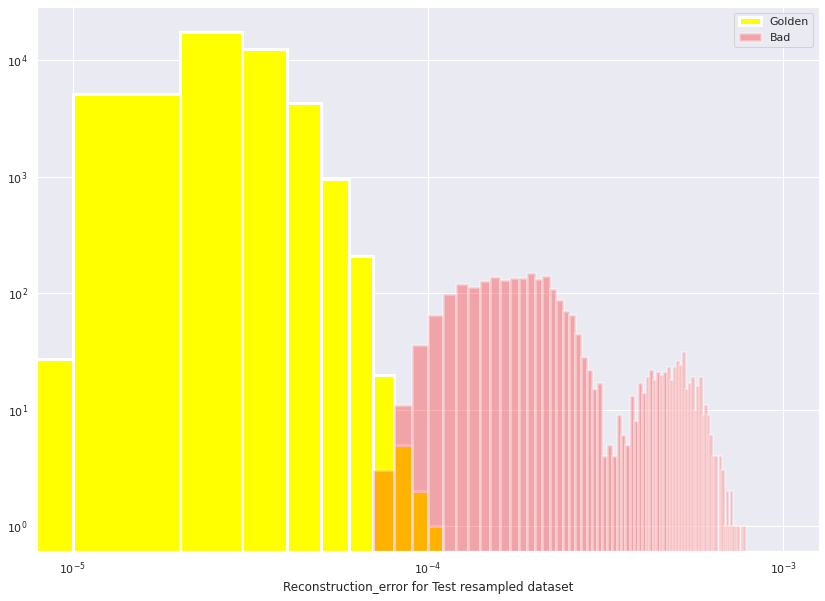

In [125]:
# reconstruction error for the normal transactions in the testing dataset
#rcParams['figure.figsize'] = 10, 8

Anomaly_error_df_test_res = error_df_test_res[(error_df_test_res['true_class'] == True)]
Golden_error_df_test_res = error_df_test_res[(error_df_test_res['true_class'] == False)]
fig = plt.figure(1)
ax = fig.add_subplot()
ax.hist(Golden_error_df_test_res.reconstruction_error.values, bins=100, range=(0., 0.0010), color = 'yellow', label= 'Test : Golden',  alpha = 1.0, lw=3, log=True)
ax.hist(Anomaly_error_df_test_res.reconstruction_error.values, bins=100, range=(0., 0.0010), color = 'red', label= 'Test : Bad',  alpha = 0.3, lw=3, log=True)
ax.set_xlabel('Reconstruction_error for Test resampled dataset')
#ax.set_alpha(0.9)
#plt.tight_layout()
plt.legend(['Golden', 'Bad'], loc='upper right')
plt.xscale('log')
#plt.xlim([7e-5, 1e-4])
plt.show()


In [150]:
#df_test['origin']=''
#df_test['origin']=X_test_all_norm.tolist()
df_res_tot['prediction2']=test_res_x_predictions.tolist()
df_res_tot['mse2']=mse_test_res
print(df_res_tot['mse2'].shape)
print(df_res_tot.at[0, 'mse2'])

(45700,)
2.3891712495250823e-05


In [152]:

def CheckAllPredictions_res(df_test, idx):

    Xmax=80000.0
    Xmin=0.0
    Xbins=100
    hname="chargeInner_PXLayer_1"
    
    ahisto=df_test.at[idx,'origin']
    #ahisto1=df_test['prediction'][run][ls]
    ahisto2=df_test.at[idx,'prediction2']
    #mse=df_test['mse'][run][ls]
    mse2=df_test.at[idx,'mse2']
    
    x= np.linspace(Xmin,Xmax,Xbins)
    #plt.xlim(Xmin,Xmax)
    
    plt.step(x, ahisto, where='mid', label="Original" )
    #plt.step(x, ahisto1, where='mid', label=" Raw Reco, mse:" + str(mse))
    plt.step(x, ahisto2, where='mid', label=" Reco, mse:" + str(mse2))
    plt.xlabel("Charge electrons")
    plt.ylabel("A.U")
    plt.legend(bbox_to_anchor=(0, 1), loc='lower right', ncol=1)
    plt.show()

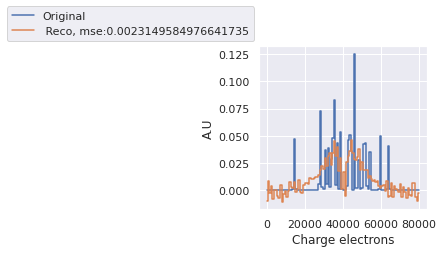

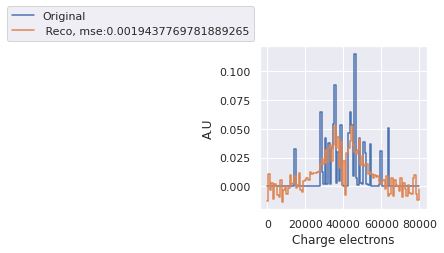

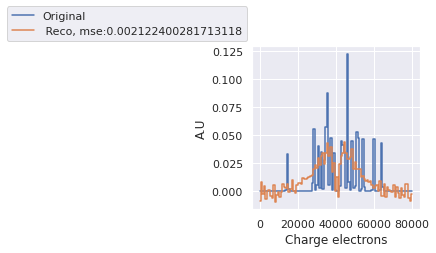

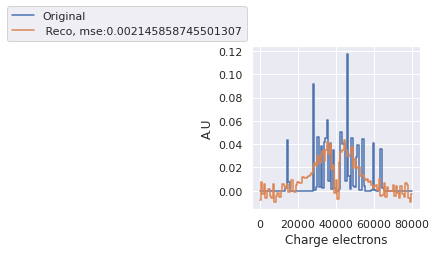

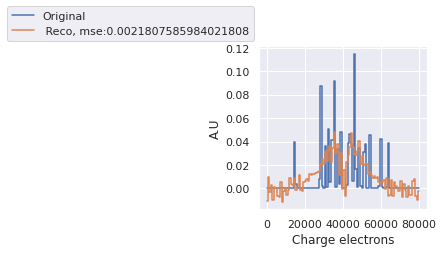

...

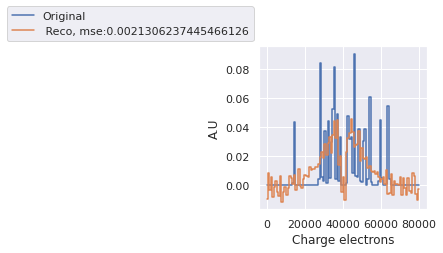

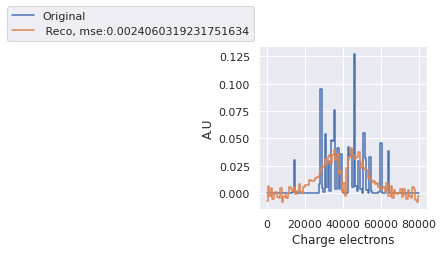

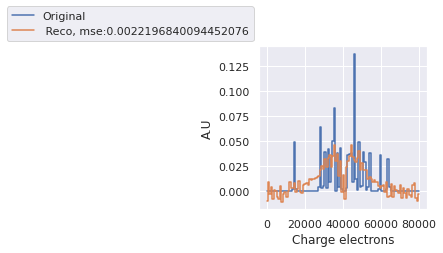

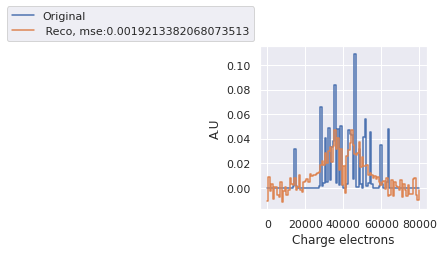

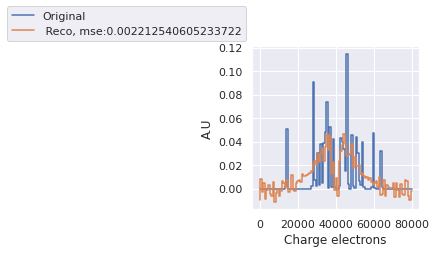

In [ ]:
rcParams['figure.figsize'] = 3, 3
#for run in df_res_test['fromrun'].unique():
#    count=0
    #if run <298000: continue
#    for ls in df_test['fromlumi'][run]: 
        #if df['train'][run][ls]== True: continue
        #if ((df_test['mse2'][run][ls]<0.0001) or (df_test['mse2'][run][ls] > 0.0002)) : continue
#if df_test['mse2'] > 0.0001 : continue
        #if df['entries'][run][ls]<3000: continue
        #if (count >2): continue
        #count=count+1
        #print(df.entries)[run][ls]
for i in np.arange(0,45700) :
  if df_res_tot.at[i, 'mse2'] < 1e-3 : continue
  CheckAllPredictions_res(df_res_tot, i)

In [ ]:
print(X_train_true_norm.shape)
print(X_valid_true_norm.shape)
print(X_test_true_norm.shape)

NameError: ignored

In [ ]:
#LSTM
from numpy import array
from keras.models import Sequential
from keras.models import Sequential
from keras import optimizers
from keras.layers import LSTM
from keras.layers import Dense
from keras.layers import RepeatVector
from keras.layers import TimeDistributed
from keras.utils import plot_model
from keras.layers.advanced_activations import ReLU

lr = 0.0001
# reshape input into [samples, timesteps, features]
timesteps = len(X_train_true_norm[0])
n_samples = X_train_true_norm.shape[0]
n_features = 1
X_train_lstm = X_train_true_norm.reshape((n_samples, timesteps, 1))
print(X_train_lstm.shape)

timesteps_valid = len(X_valid_true_norm[0])
n_samples_valid = X_valid_true_norm.shape[0]
n_features = 1
X_valid_lstm = X_valid_true_norm.reshape((n_samples_valid, timesteps_valid, 1))

lstm_autoencoder = Sequential()
# Encoder
lstm_autoencoder.add(LSTM(10, activation='tanh', input_shape=(timesteps, n_features), return_sequences=True))
lstm_autoencoder.add(LSTM(3, activation='tanh', return_sequences=False))
lstm_autoencoder.add(RepeatVector(timesteps))
# Decoder
lstm_autoencoder.add(LSTM(3, activation='tanh', return_sequences=True))
lstm_autoencoder.add(LSTM(10, activation='tanh', return_sequences=True))
lstm_autoencoder.add(TimeDistributed(Dense(n_features)))

lstm_autoencoder.summary()



(129382, 100, 1)
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 100, 10)           480       
_________________________________________________________________
lstm_2 (LSTM)                (None, 3)                 168       
_________________________________________________________________
repeat_vector_1 (RepeatVecto (None, 100, 3)            0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 100, 3)            84        
_________________________________________________________________
lstm_4 (LSTM)                (None, 100, 10)           560       
_________________________________________________________________
time_distributed_1 (TimeDist (None, 100, 1)            11        
Total params: 1,303
Trainable params: 1,303
Non-trainable params: 0
___________________________________

In [ ]:
epochs=100
batch=500

adam = optimizers.Adam(lr)
lstm_autoencoder.compile(loss='mse', optimizer=adam)

cp = ModelCheckpoint(filepath="/content/drive/My Drive/Colab Notebooks/lstm_autoencoder_classifier.h5",
                               save_best_only=True,
                               verbose=0)

tb = TensorBoard(log_dir='/content/drive/My Drive/Colab Notebooks/lstm_logs',
                histogram_freq=0,
                write_graph=True,
                write_images=True)

lstm_autoencoder_history = lstm_autoencoder.fit(X_train_lstm, X_train_lstm, 
                                                epochs=epochs, 
                                                batch_size=batch, 
                                                validation_data=(X_valid_lstm, X_valid_lstm),
                                                verbose=2).history

Train on 129382 samples, validate on 32421 samples
Epoch 1/100
 - 181s - loss: 2.1108e-04 - val_loss: 1.9895e-04
Epoch 2/100
 - 179s - loss: 1.1894e-04 - val_loss: 3.4616e-05
Epoch 3/100
 - 176s - loss: 3.1598e-05 - val_loss: 3.0539e-05
Epoch 4/100
 - 176s - loss: 3.0371e-05 - val_loss: 3.0077e-05
Epoch 5/100
 - 176s - loss: 3.0051e-05 - val_loss: 2.9879e-05
Epoch 6/100
 - 176s - loss: 2.9889e-05 - val_loss: 2.9773e-05
Epoch 7/100
 - 176s - loss: 2.9783e-05 - val_loss: 2.9677e-05
Epoch 8/100
 - 176s - loss: 2.9703e-05 - val_loss: 2.9597e-05
Epoch 9/100
 - 177s - loss: 2.9646e-05 - val_loss: 2.9574e-05
Epoch 10/100
 - 176s - loss: 2.9580e-05 - val_loss: 2.9474e-05
Epoch 11/100
 - 176s - loss: 2.9531e-05 - val_loss: 2.9466e-05
Epoch 12/100
 - 175s - loss: 2.9491e-05 - val_loss: 2.9440e-05
Epoch 13/100
 - 176s - loss: 2.9443e-05 - val_loss: 2.9337e-05
Epoch 14/100
 - 175s - loss: 2.9391e-05 - val_loss: 2.9306e-05
Epoch 15/100
 - 176s - loss: 2.9343e-05 - val_loss: 2.9234e-05
Epoch 16/100


In [ ]:
plt.plot(lstm_autoencoder_history['loss'], linewidth=2, label='Train')
plt.plot(lstm_autoencoder_history['val_loss'], linewidth=2, label='Valid')
plt.legend(loc='upper right')
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.yscale("log")
plt.show()

NameError: ignored

In [ ]:
X_valid_all = np.stack(df_valid['histo'].values, axis=0)
X_valid_all_norm=normalize(X_valid_all, norm='l1', axis=1)

valid_x_predictions = autoencoder.predict(X_valid_all_norm)
#mse = np.mean(np.power(df_valid_x_rescaled - valid_x_predictions, 2), axis=1)
mse_valid=K.eval(mseTop10(X_valid_all_norm, valid_x_predictions))
error_df = pd.DataFrame({'Reconstruction_error': mse_valid,
                        'True_class': df_valid['labels']})
precision_rt, recall_rt, threshold_rt = precision_recall_curve(error_df.True_class, error_df.Reconstruction_error)
plt.plot(threshold_rt, precision_rt[1:], label="Precision",linewidth=5)
plt.plot(threshold_rt, recall_rt[1:], label="Recall",linewidth=5)
plt.title('Precision and recall for different threshold values')
plt.xlabel('Threshold')
plt.ylabel('Precision/Recall')
plt.legend()
plt.show()

In [ ]:
0#extract test and train data and put in dataframes

#df_train=df.loc[df['labels']==True]
#df_test=df.loc[df['labels']==False]
X_trainCol = np.stack(df['histo'][df['labels']==True].values, axis=1) #convert list of array to a stack to feed the model
X_testCol = np.stack(df['histo'][df['labels']==False].values, axis=1)
X_trainS = np.stack(df['histo'][df['labels']==True].values, axis=0) #convert list of array to a stack to feed the model
X_testS = np.stack(df['histo'][df['labels']==False].values, axis=0)

print(X_trainCol.shape , X_trainS.shape)
print(X_trainCol)
print(X_trainS)

from sklearn.preprocessing import normalize

X_train=normalize(X_trainS, norm='l1', axis=1) #normalise the sample, i.e the rows
X_test=normalize(X_testS, norm='l1', axis=1)
print(X_train)
                      
df['origin']=''
df['origin'].loc[df['labels']==True]=X_train.tolist()
df['origin'].loc[df['labels']==False]=X_test.tolist()
print(df.shape)
print(df.origin.shape)

(100, 202299) (202299, 100)
[[ 33  43  34 ...  11   6   0]
 [213 201 241 ...  43  47   2]
 [426 389 362 ...  74  62   1]
 ...
 [ 54  65  43 ...   0   2   0]
 [ 52  74  49 ...   0   0   0]
 [ 67  50  55 ...   0   0   0]]
[[ 33 213 426 ...  54  52  67]
 [ 43 201 389 ...  65  74  50]
 [ 34 241 362 ...  43  49  55]
 ...
 [ 11  43  74 ...   0   0   0]
 [  6  47  62 ...   2   0   0]
 [  0   2   1 ...   0   0   0]]
[[0.0001941  0.00125283 0.00250566 ... 0.00031762 0.00030586 0.00039408]
 [0.00026486 0.00123807 0.00239607 ... 0.00040037 0.00045581 0.00030798]
 [0.00021593 0.00153059 0.00229905 ... 0.00027309 0.0003112  0.0003493 ]
 ...
 [0.00108868 0.00425574 0.00732383 ... 0.         0.         0.        ]
 [0.00059137 0.00463237 0.00611078 ... 0.00019712 0.         0.        ]
 [0.         0.00611621 0.0030581  ... 0.         0.         0.        ]]


/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)


(225954, 12)
(225954,)


ValueError: ignored

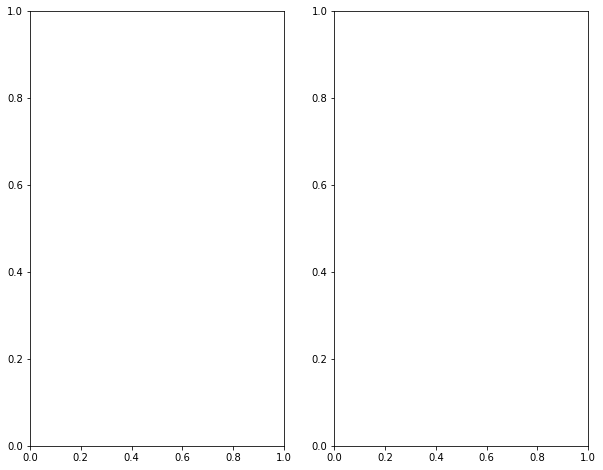

In [ ]:
color = {False:'red', True:'green'}
Bad=df[df['labels']==False]
Good=df[df['labels']==True]
#fraudlist = creditData[creditData.Class == 1]
#normal = creditData[creditData.Class == 0]
fig,axes = plt.subplots(1,2)
axes[0].scatter(list(range(1,Bad.shape[0] + 1)), X_train, color='red')
axes[1].scatter(list(range(1, Good.shape[0] + 1)),X_test, color='green')
plt.show()

In [ ]:
array_good=np.array(X_trainCol)
array_bad = np.array(X_testCol)

mean_good=np.mean(array_good, axis=1)
mean_bad=np.mean(array_bad, axis=1)

std_good=np.std(array_good, axis=1)
std_bad = np.std(array_bad, axis=1)

print(mean_good.shape)
print(std_good.shape)
print(mean_good)
print(std_good)


#bin =[]

#for i in range(1,101):
#    bin.append(i)

#print(bin)    
#np.reshape(bin, (100,1))
#print(bin.shape)
bin=np.arange(1,101)
bin.shape

#np.reshape(bin, (100,1))
#plt.plot(bin,mean_good)
plt.figure(1)
plt.errorbar(bin, mean_good, yerr=std_good, ecolor = 'green', label='both limits (default)')
plt.figure(2)
plt.errorbar(bin, mean_bad, yerr=std_bad, ecolor = 'red', label='both limits (default)')
plt.figure(3)
plt.errorbar(bin, mean_good, yerr=std_good, ecolor = 'green', label='both limits (default)')
plt.errorbar(bin, mean_bad, yerr=std_bad, ecolor = 'red', label='both limits (default)')
plt.show()
plt.figure(4)
plt.plot(bin, mean_good, color = 'green')
plt.plot(bin, mean_bad, color = 'red')
plt.figure(5)
plt.plot(bin, std_good, color = 'green')
plt.plot(bin, std_bad, color = 'red')
plt.show()


In [ ]:
#build the model
import math
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras.layers import Input
from keras.layers.advanced_activations import PReLU
from keras.models import Model
from keras import backend as K
import tensorflow as tf
from keras.models import load_model

def mseTop10(y_true, y_pred):
    top_values, _ = tf.nn.top_k(K.square(y_pred - y_true), k=10, sorted=True)
    mean=K.mean(top_values, axis=-1)
    return mean


input_size=len(X_train[0])
print(input_size)
input_layer = Input(shape=(input_size, ))
encoded = Dense(10, activation='tanh')(input_layer)
encoded1 = Dense(3, activation='tanh')(encoded)
encoded2 = Dense(10, activation='tanh')(encoded1)
decoder = Dense(input_size, activation='tanh')(encoded2)

autoencoder = Model(inputs=input_layer, outputs=decoder)
autoencoder.compile(optimizer='adam', loss=mseTop10)

for i, layer in enumerate(autoencoder.layers):
             layer.name = 'layer_' + str(i)

autoencoder.summary()

In [ ]:
history = autoencoder.fit(X_train,X_train, epochs=100, batch_size=500, shuffle=False, verbose=1,validation_split=0.1)

In [ ]:
#print(history)

line_styles = [(0, ()), (0, (1, 3)), (0, (3, 2))]

color_palette = {"Indigo": {
                    50: "#E8EAF6",
                    100: "#C5CAE9",
                    200: "#9FA8DA",
                    300: "#7986CB",
                    400: "#5C6BC0",
                    500: "#3F51B5",
                    600: "#3949AB",
                    700: "#303F9F",
                    800: "#283593",
                    900: "#1A237E"},
                 "Teal": {      
                    50: "#E0F2F1",
                    100: "#B2DFDB",
                    200: "#80CBC4",
                    300: "#4DB6AC",
                    400: "#26A69A",
                    500: "#009688",
                    600: "#00897B",
                    700: "#00796B",
                    800: "#00695C",
                    900: "#004D40"}
                }

def plot_loss(data, title):
    """Plots the training and validation loss"""
    plt.figure()
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title(title)
    plt.plot(data.history['loss'], linestyle=line_styles[0], color=color_palette["Indigo"][900], linewidth=3)
    plt.plot(data.history['val_loss'], linestyle=line_styles[2], color=color_palette["Teal"][300], linewidth=3)
    plt.legend(["Train", "Validation"], loc="upper right", frameon=False)
    #plt.ylim(8258339,8258400)
    plt.yscale("log")
    plt.xlim(0,100)
    plt.show();

plot_loss(history, "Original model loss")

In [ ]:
#LSTM
from numpy import array
from keras.models import Sequential
from keras.models import Sequential
from keras.layers import LSTM
from keras.layers import Dense
from keras.layers import RepeatVector
from keras.layers import TimeDistributed
from keras.utils import plot_model
from keras.layers.advanced_activations import ReLU

# define input sequence
X_train_lstm=normalize(X_trainS, norm='l1', axis=1)
X_test_lstm=normalize(X_testS, norm='l1', axis=1)
                      
df['lstm']=''
df['lstm'].loc[df['labels']==True]=X_train_lstm.tolist()
df['lstm'].loc[df['labels']==False]=X_test_lstm.tolist()

#sequence = array([0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])
#print(sequence.shape)
#n_in_seq = len(sequence)
#print(n_in_seq)
#sequence = sequence.reshape((1, n_in_seq, 1))
#print(sequence.shape)

# reshape input into [samples, timesteps, features]
n_in = len(X_train_lstm[0])
print(n_in)
print(X_train_lstm.shape)
X_train_lstm = X_train_lstm.reshape((202299, n_in, 1))
print(X_train_lstm.shape)
# define model
n_in = len(X_train_lstm[0])
model = Sequential()
model.add(LSTM(10, activation='tanh', input_shape=(n_in,1)))
model.add(RepeatVector(n_in))
model.add(LSTM(10, activation='tanh', return_sequences=True))
model.add(TimeDistributed(Dense(1)))
model.compile(optimizer='adam', loss='mse')
for i, layer in enumerate(model.layers):
             layer.name = 'layer_' + str(i)

model.summary()
#history_lstm = model.fit(X_train_lstm,X_train_lstm, epochs=60, batch_size=500, shuffle=False, verbose=1,validation_split=0.1)
# fit model
#model.fit(sequence, sequence, epochs=300, verbose=0)
#plot_model(model, show_shapes=True, to_file='reconstruct_lstm_autoencoder.png')

In [ ]:
#print(history)

line_styles = [(0, ()), (0, (1, 3)), (0, (3, 2))]

color_palette = {"Indigo": {
                    50: "#E8EAF6",
                    100: "#C5CAE9",
                    200: "#9FA8DA",
                    300: "#7986CB",
                    400: "#5C6BC0",
                    500: "#3F51B5",
                    600: "#3949AB",
                    700: "#303F9F",
                    800: "#283593",
                    900: "#1A237E"},
                 "Teal": {      
                    50: "#E0F2F1",
                    100: "#B2DFDB",
                    200: "#80CBC4",
                    300: "#4DB6AC",
                    400: "#26A69A",
                    500: "#009688",
                    600: "#00897B",
                    700: "#00796B",
                    800: "#00695C",
                    900: "#004D40"}
                }

def plot_loss(data, title):
    """Plots the training and validation loss"""
    plt.figure()
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title(title)
    plt.plot(data.history['loss'], linestyle=line_styles[0], color=color_palette["Indigo"][900], linewidth=3)
    plt.plot(data.history['val_loss'], linestyle=line_styles[2], color=color_palette["Teal"][300], linewidth=3)
    plt.legend(["Train", "Validation"], loc="upper right", frameon=False)
    #plt.ylim(8258339,8258400)
    plt.yscale("log")
    plt.xlim(0,60)
    plt.show();

plot_loss(history_lstm, "Original model loss for LSTM")

In [ ]:
predictionTest=autoencoder.predict(X_test)
predictionTrain=autoencoder.predict(X_train)

mseTest=K.eval(mseTop10(X_test, predictionTest))
mseTrain=K.eval(mseTop10(X_train, predictionTrain))

df['prediction']=""
df['mse']=""

df['prediction'].loc[df['labels']==True]=predictionTrain.tolist()
df['prediction'].loc[df['labels']==False]=predictionTest.tolist()

df['mse'].loc[df['labels']==True]=mseTrain
df['mse'].loc[df['labels']==False]=mseTest

print(df.head())
#print(df_test.head())


In [ ]:
def globalMSETrend(df,type=1):
    
    y=[]
    
    rmax=0
    rmin=10
    
    print(rmax, rmin)
    for run in df['fromrun'].unique():
        if (type==1): val=(df['mse'][run]).mean()
        if (type==2): val=(df['mse2'][run]).mean()
        if val > rmax: rmax=val
        if val < rmin: rmin =val
        y.append(val)
    
    array=np.array(y)
    gmean=array.mean()
    size=float(array.size)
    gstd=array.std()
    print(size)
    
    fig=plt.figure()
    fig.set_size_inches(16, 9)
    
    plt.hlines(gmean,df['fromrun'].unique().min(), df['fromrun'].unique().max(), color="blue", label="Run average: " + str(gmean))
    plt.hlines(gmean+(1.0*gstd), df['fromrun'].unique().min(), df['fromrun'].unique().max(), color="red", label='1 SD (' + str(gstd) + ")")
    plt.hlines(gmean+(3.0*gstd), df['fromrun'].unique().min(), df['fromrun'].unique().max(), color="red", label='3 SD', linestyle=':')
    
    plt.ylim(rmin*0.9,rmax*1.1)
    plt.scatter(df['fromrun'].unique(), y, marker='+', label='Data points')
    plt.xlabel("Run")
    plt.ylabel("average MSE")
    plt.legend()
    plt.show()

In [ ]:
globalMSETrend(df[df.labels==True])

In [ ]:
def CheckPredictions(df_test, run, ls):

    Xmax=80000.0
    Xmin=0.0
    Xbins=100
    hname="chargeInner_PXLayer_1"
    
    ahisto=df_test['origin'][run][ls]
    ahisto1=df_test['prediction'][run][ls]
    mse=df_test['mse'][run][ls]
    
    x= np.linspace(Xmin,Xmax,Xbins)
    #plt.xlim(Xmin,Xmax)
    
    plt.step(x, ahisto, where='mid', label=(" Data " + str(df_test.fromlumi[run][ls]) + " Run " + str(df_test.fromrun[run][ls]) ))
    plt.step(x, ahisto1, where='mid', label=" Reco MSE=" + str(mse))
    plt.xlabel("Charge electrons")
    plt.ylabel("A.U")
    plt.legend()
    plt.show()

In [ ]:
for run in df['fromrun'].unique():
    count=0
    for ls in df['fromlumi'][run]: 
        if df['labels'][run][ls]== False: continue
        if (count >2): continue
        count=count+1
        #CheckPredictions(df[df.train==True], run,ls)
        CheckPredictions(df[df['labels']==True], run,ls)

In [ ]:
import pandas as pd
import numpy as np
#X_trainA = np.stack(df['origin'][df['labels']==True].values, axis=0) #convert list of array to a stack to feed the model
X_trainA = np.stack(df['origin'][df['labels']==True].values, axis=0)
#no need to normalize, we already have the normalized histogram in the df
print(X_trainA)

In [ ]:
input_size=len(X_train[0])
input_layerA = Input(shape=(input_size, ))

encodedA = Dense(20, activation='sigmoid')(input_layerA)
encoded1A = Dense(10, activation='tanh')(encodedA)
encoded2A = Dense(20, activation='sigmoid')(encoded1A)
decoderA = Dense(input_size, activation='sigmoid')(encoded2A)

autoencoder_Opt = Model(inputs=input_layerA, outputs=decoderA)
autoencoder_Opt.compile(optimizer='adam', loss=mseTop10)

for i, layer in enumerate(autoencoder_Opt.layers):
             layer.name = 'layer_' + str(i)

autoencoder_Opt.summary()

In [ ]:
history_Opt = autoencoder_Opt.fit(X_trainA,X_trainA, epochs=300, batch_size=100, shuffle=True, verbose=1,validation_split=0.1)

In [ ]:
#calculate predictions and mse and add to original DF

originS=np.stack(df['origin'].values, axis=0)
predictionA=autoencoder_Opt.predict(originS)

mseA=K.eval(mseTop10(originS,predictionA))

df['predictions2']=""
df['mse2']=""

df['prediction2']=predictionA.tolist()
df['mse2']=mseA


print(df.head())

In [ ]:
def CheckAllPredictions(df_test, run, ls):

    Xmax=80000.0
    Xmin=0.0
    Xbins=100
    hname="chargeInner_PXLayer_1"
    
    ahisto=df_test['origin'][run][ls]
    ahisto1=df_test['prediction'][run][ls]
    ahisto2=df_test['prediction2'][run][ls]
    mse=df_test['mse'][run][ls]
    mse2=df_test['mse2'][run][ls]
    
    x= np.linspace(Xmin,Xmax,Xbins)
    #plt.xlim(Xmin,Xmax)
    
    plt.step(x, ahisto, where='mid', label=(" Data " + str(df_test.fromlumi[run][ls]) + " Run " + str(df_test.fromrun[run][ls]) ))
    plt.step(x, ahisto1, where='mid', label=" Raw Reco, mse:" + str(mse))
    plt.step(x, ahisto2, where='mid', label=" Reco, mse:" + str(mse2))
    plt.xlabel("Charge electrons")
    plt.ylabel("A.U")
    plt.legend()
    plt.show()

In [ ]:
#compare some old and new predictions

for run in df['fromrun'].unique():
    count=0
    if run <298000: continue
    for ls in df['fromlumi'][run]: 
        if df['train'][run][ls]== True: continue
        if df['mse2'][run][ls]<0.00001: continue
        if df['entries'][run][ls]<3000: continue
        #if (count >2): continue
        count=count+1
        #print(df.entries)[run][ls]
        CheckAllPredictions(df[df.train==False], run,ls)